# Tanmay Garg
## CS20BTECH11063
## Deep Learning Assignment 3

In [1]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import math
import torch.functional as F
import torch.nn as nn
from sklearn.utils import shuffle
import PIL
from PIL import Image
import cv2
import os
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils
import torch.optim as optim

# Q1

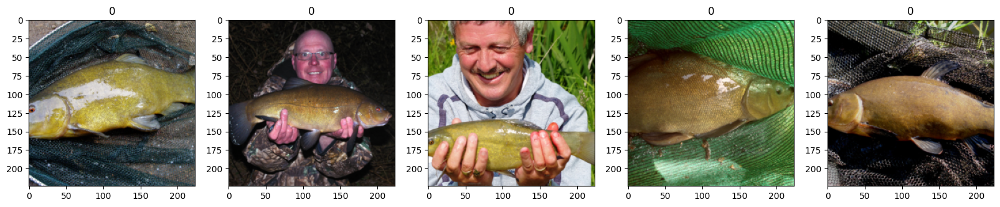

In [2]:
# Download ResNet50 model
import torchvision.models as models
import torchvision.transforms as transforms
import torchvision.datasets as datasets
import torchvision

resnet50 = models.resnet50(weights=models.ResNet50_Weights.DEFAULT)

# Define the transform
transform = transforms.Compose([
                transforms.Resize(232),
                transforms.CenterCrop(224),
                transforms.ToTensor(),
                transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                        std=[0.229, 0.224, 0.225])
                                ])
# transform = models.ResNet50_Weights.IMAGENET1K_V2.transforms()

# Validation Dataset Images of ImageNet Dataset has been used to visualize the gradients
val_dataset = datasets.ImageFolder(root='images', transform=transform)
# create a data loader
val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=5, shuffle=True)

# Plot the images by denormalizing the images
denormalize = transforms.Normalize(mean=[-0.485/0.229, -0.456/0.224, -0.406/0.225],
                                    std=[1/0.229, 1/0.224, 1/0.225])  
fig, ax = plt.subplots(1, 5, figsize=(20, 10))
for i in range(5):
    ax[i].imshow(denormalize(val_dataset[i][0]).permute(1, 2, 0))
    ax[i].set_title(val_dataset[i][1])
plt.show()

# fig, ax = plt.subplots(1, 5, figsize=(20, 10))
# for i in range(5):
#     ax[i].imshow(val_dataset[i][0].permute(1, 2, 0))
#     ax[i].set_title(val_dataset[i][1])
# plt.show()


The above images are part of the validation dataset of ImageNet dataset. Total 50 images have been used for this assignment. 5 classes and each class has 10 images is structure of ```images``` folder. Each folder is named as their numeric class label according to ImageNet instructions

Considering the neuron corresponding to the highest predicted score in the output layer, implement and visualize the results for Vanilla Backpropagation, Guided Backpropagation, CAM and GradCAM.

## Vanilla Backpropagation

In [3]:
class VanillaBackprop():
    def __init__(self, model):
        # Initialize the VanillaBackprop class with a model and set it to evaluation mode
        self.model = model
        self.model = models.resnet50(weights=models.ResNet50_Weights.DEFAULT)
        self.model.eval()
        self.gradients = None
        self.num_images = 0
    
    # Compute the gradients for the given image
    def calculate_gradients(self, image, target_class=None):
        image.requires_grad = True
        self.num_images = image.shape[0]
        self.model.eval()
        
        # Compute the output of the model for the given image
        output = self.model(image)
        target_class = torch.argmax(output, dim=1)
        # print("Output Shape: ", output.shape)
        # print("Target Class: ", target_class)
        
        # Set the gradients to zero
        self.model.zero_grad()
        
        # Create a one-hot vector based on the target class
        one_hot_vector = torch.zeros(output.shape)
        one_hot_vector[torch.arange(self.num_images), target_class] = 1
        
        # Perform backprop with respect to the one-hot vector
        output.backward(gradient=one_hot_vector)

        # pred = output.argmax(dim=1, keepdim=True)
        
        # output[:, pred].sum().backward()
        
        self.gradients = image.grad
        # bring the gradients to [0, 1] range for each image separately
        for i in range(self.num_images):
            self.gradients[i] = self.gradients[i] - self.gradients[i].min()
            self.gradients[i] = self.gradients[i] / self.gradients[i].max()
        return self.gradients
    
    def plot_gradients(self, image):
        # fig, ax = plt.subplots(self.num_images, 2, figsize=(5, 100))
        # # print(self.num_images)
        # # self.gradients = self.gradients - self.gradients.min()
        # # self.gradients = self.gradients / self.gradients.max()
        # for i in range(self.num_images):
        #     ax[i, 0].imshow(denormalize(image[i]).permute(1, 2, 0))
        #     ax[i, 1].imshow(self.gradients[i].permute(1, 2, 0))
        # # plt.show()
        # # plt.savefig('vanilla_backprop.png')
        # plt.show()
        # plt.close()
        
        fig, ax = plt.subplots(1, 2, figsize=(5, 5))
        ax[0].imshow(denormalize(image[0]).permute(1, 2, 0))
        ax[1].imshow(self.gradients[0].permute(1, 2, 0))
        # ax[0].title = "Original Image"
        # ax[1].title = "Gradients"
        plt.show()
        plt.close()
    
        

Images Shape:  torch.Size([50, 3, 224, 224])


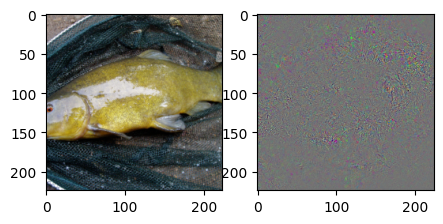

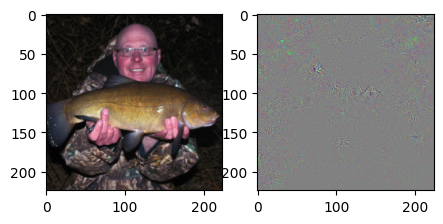

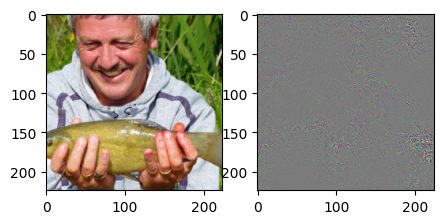

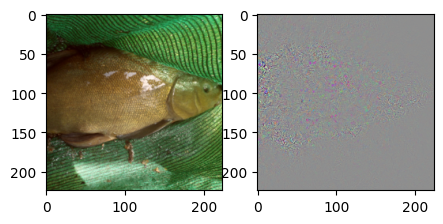

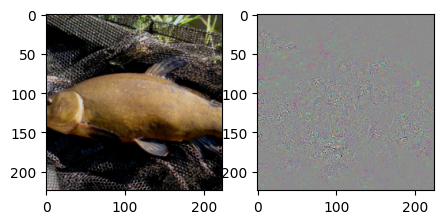

...

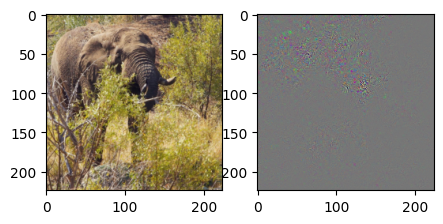

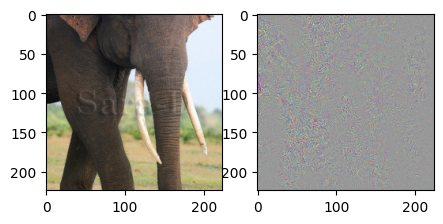

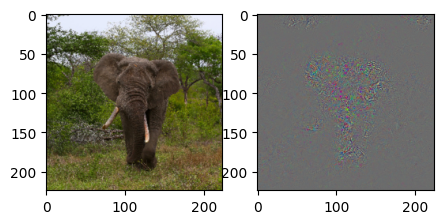

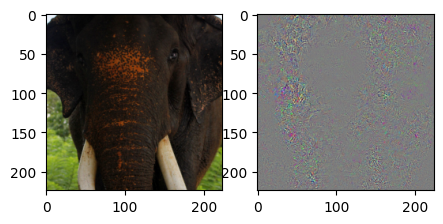

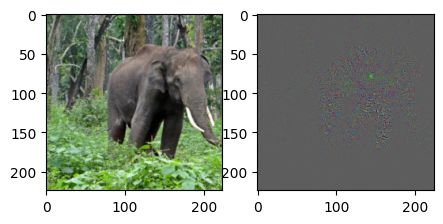

In [4]:
vanilla_back = VanillaBackprop(resnet50)
images = []
target_class = []
# for i in range(len(val_dataset)):
#     images.append(val_dataset[i][0])
#     target_class.append(val_dataset[i][1])
# images = torch.stack(images)
# print("Images Shape: ", images.shape)
# gradients = vanilla_back.calculate_gradients(images.detach(), target_class)
# vanilla_back.plot_gradients(images.detach())
for i in range(len(val_dataset)):
    images.append(val_dataset[i][0])
    target_class.append(val_dataset[i][1])
images = torch.stack(images)
print("Images Shape: ", images.shape)

for i in range(len(images)):
    vanilla_gradients = vanilla_back.calculate_gradients(images[i].unsqueeze(0).detach(), [target_class[i]])
    vanilla_back.plot_gradients(images[i].unsqueeze(0).detach())

# vanilla_gradients = vanilla_back.calculate_gradients(images.detach(), target_class)
# print(vanilla_gradients.shape)
# vanilla_back.plot_gradients(images.detach())


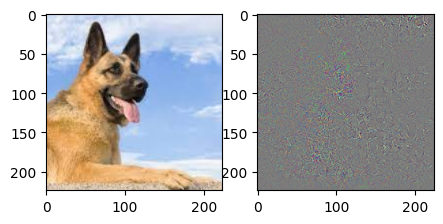

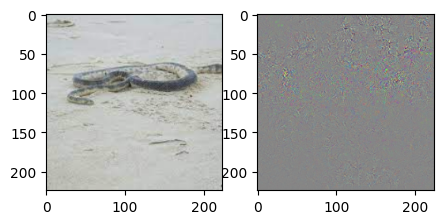

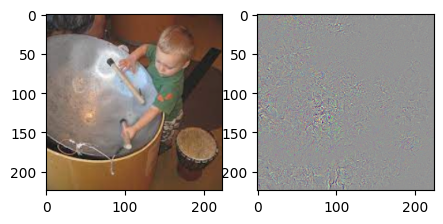

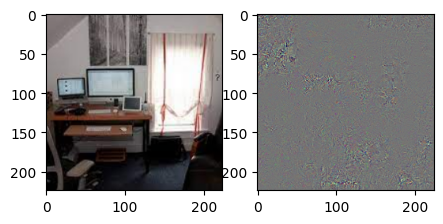

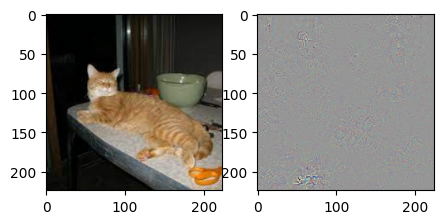

In [5]:
vanilla_back2 = VanillaBackprop(resnet50)
img_list = []
img_list.append('images2/i1.jpg')
img_list.append('images2/i2.jpg')
img_list.append('images2/i3.jpg')
img_list.append('images2/i4.jpg')
img_list.append('images2/i5.jpg')

for path in img_list:
    img = Image.open(path)
    img = transform(img).unsqueeze(0)
    vanilla_gradients = vanilla_back2.calculate_gradients(img.detach(), [0])
    vanilla_back2.plot_gradients(img.detach())

## Guided Backpropagation

In [6]:
class GuidedBackprop():
    def __init__(self, model):
        self.model = models.resnet50(weights=models.ResNet50_Weights.DEFAULT)
        self.model.eval()
        self.gradients = None
        self.num_images = 0
        self.activations = []
        # Register forward and backward hooks for ReLU layers
        self.relu_hook()

    def relu_hook(self):
        def modified_relu_grad(module, grad_in, grad_out):
            # Get the stored activation of the current layer
            output = self.activations.pop()
            # print("Output Shape: ", output[0].shape)
            # print("Grad Out Shape: ", grad_out[0].shape)
            # Set all elements in output to 1 if they are > 0 as we want to clip the gradients based on +ve and -ve
            output = (output[0] > 0).float()
            # multiply output with the gradient of the output which are clamp to 0
            output = output * torch.max(grad_out[0], torch.tensor(0.0))
            return (output,)
            # return (torch.max(grad_out[0], torch.tensor(0.0)),)
        
        # Store the output activation of the current layer
        def activation_append(module, input, output):
            self.activations.append(input)
            
        # Register forward and backward hooks for all ReLU layers in the model
        for name, module in self.model.named_modules():
            if isinstance(module, nn.ReLU):
                # module.register_full_backward_hook(backward_hook)
                module.register_backward_hook(modified_relu_grad)
                module.register_forward_hook(activation_append)
            
    def calculate_gradients(self, image, target_class=None):
        image.requires_grad = True
        self.num_images = image.shape[0]
        self.model.eval()
        
        # Forward pass to obtain model output
        output = self.model(image)
        # print("Output Shape: ", output.shape)
        # print("Target Class: ", target_class)
        # Clear gradients
        self.model.zero_grad()
        target_class = torch.argmax(output, dim=1)
        # Create a one-hot vector based on the target class
        one_hot_vector = torch.zeros(output.shape)
        one_hot_vector[torch.arange(self.num_images), target_class] = 1
        
        # Backward pass to compute gradients with respect to the one-hot vector
        output.backward(gradient=one_hot_vector)
        
        # Gradients with respect to the input image
        self.gradients = image.grad
        # bring the gradients to [0, 1] range for each image separately
        for i in range(self.num_images):
            self.gradients[i] = self.gradients[i] - self.gradients[i].min()
            self.gradients[i] = self.gradients[i] / self.gradients[i].max()
        
        return self.gradients
    
    def plot_gradients(self, image):
        # fig, ax = plt.subplots(self.num_images, 2, figsize=(5, 100))
        # for i in range(self.num_images):
        #     ax[i, 0].imshow(denormalize(image[i]).permute(1, 2, 0))
        #     # ax[i, 0].axis('off')
        #     ax[i, 1].imshow(self.gradients[i].permute(1, 2, 0))
        #     # ax[i, 1].axis('off')
        # fig.tight_layout()
        # plt.savefig('guided_backprop.png')
        # plt.show()
        # plt.close()
        fig, ax = plt.subplots(1, 2, figsize=(5, 5))
        ax[0].imshow(denormalize(image[0]).permute(1, 2, 0))
        ax[1].imshow(self.gradients[0].permute(1, 2, 0))
        # ax[0].title = 'Original Image'
        # ax[1].title = 'Guided Backprop'
        plt.show()
        plt.close()
        
    def guided_backprop(self, image, target_class=None):
        self.calculate_gradients(image, target_class)
        
        self.plot_gradients(image.detach())
        return self.gradients


Images Shape:  torch.Size([50, 3, 224, 224])


c:\Users\sumit\AppData\Local\Programs\Python\Python39\lib\site-packages\torch\nn\modules\module.py:1053: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "


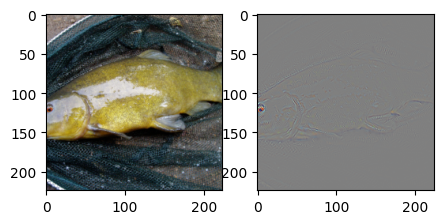

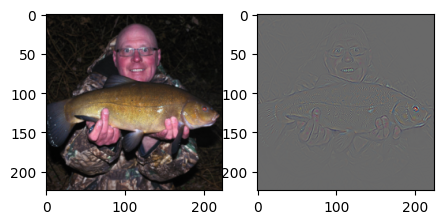

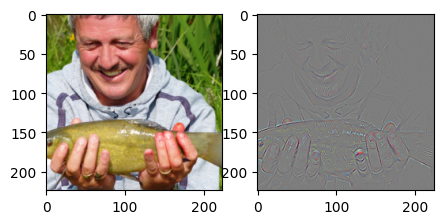

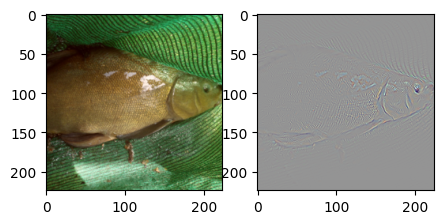

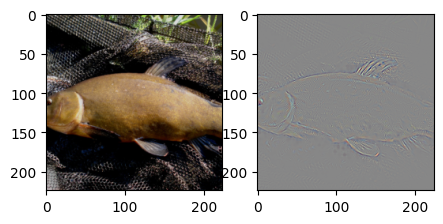

...

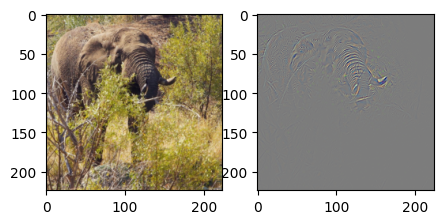

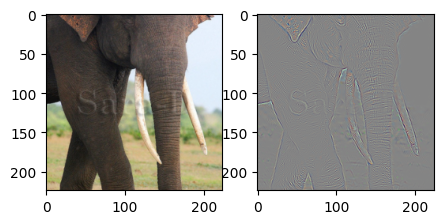

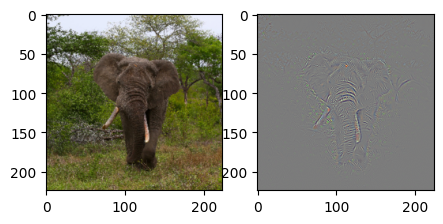

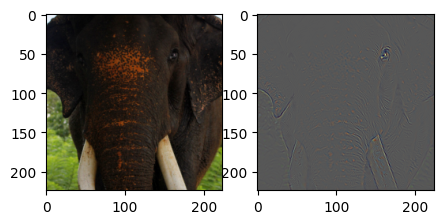

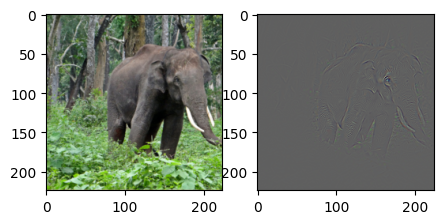

In [7]:
guided_back = GuidedBackprop(resnet50)
images = []
for i in range(len(val_dataset)):
    images.append(val_dataset[i][0])
images = torch.stack(images)
print("Images Shape: ", images.shape)
# gradients_guided = guided_back.guided_backprop(images.detach(), target_class)

for i in range(len(images)):
    gradients_guided = guided_back.guided_backprop(images[i].unsqueeze(0).detach(), [target_class[i]])


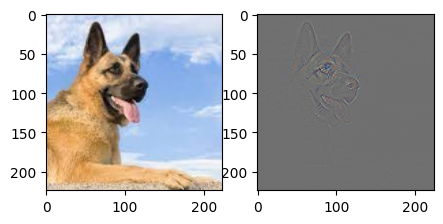

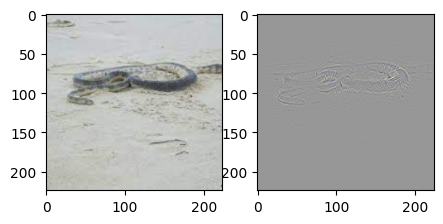

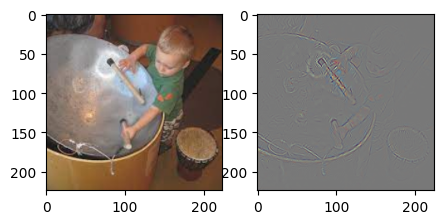

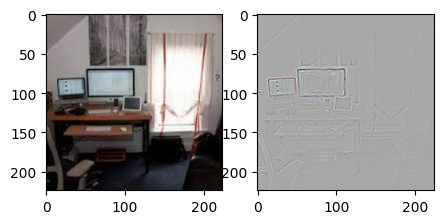

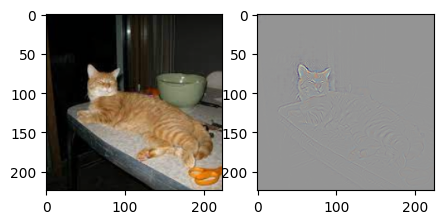

In [8]:
guided_back2 = GuidedBackprop(resnet50)
img_list = []
img_list.append('images2/i1.jpg')
img_list.append('images2/i2.jpg')
img_list.append('images2/i3.jpg')
img_list.append('images2/i4.jpg')
img_list.append('images2/i5.jpg')

for path in img_list:
    img = Image.open(path)
    img = transform(img).unsqueeze(0)
    gradients_guided = guided_back2.guided_backprop(img.detach(), [0])

## Class Activation Map

In [19]:
class CAM(nn.Module):
    def __init__(self, model):
        super(CAM, self).__init__()
        self.resnet_model = models.resnet50(weights=models.ResNet50_Weights.DEFAULT)
        self.conv_layers = nn.Sequential(*list(self.resnet_model.children())[:-2])
        # print(self.conv_layers)
        self.gap_layer = model.avgpool
        self.fc_layer = model.fc
        
        # params = list(self.fc_layer.parameters())
        # weight = torch.squeeze(params[0].data)
        # self.fc_weight = weight
        # self.fc_weight = torch.squeeze(self.fc_layer.weight.data)
        self.fc_weight = self.fc_layer.weight.data.squeeze()
        # print(weight.shape)
        
    def forward(self, x):
        x = self.conv_layers(x)
        # print(x.shape)
        x = self.gap_layer(x)
        # print(x.shape)
        x = x.view(x.size(0), -1)
        # print(x.shape)
        x = self.fc_layer(x)
        # print(x.shape)
        return x
    
    def generate_cam(self, image):
        self.resnet_model.eval()
        output_pred = self.resnet_model(image)
        # print(output_pred.shape)
        # applying softmax to get the probabilities
        output_pred = nn.Softmax(dim=1)(output_pred).squeeze()
        # print("Output Pred: ", output_pred.shape)
        # print(torch.max(output_pred, dim=1))
        # print(torch.sum(output_pred, dim=1))
        # sort the probabilities in descending order
        _, index = torch.sort(output_pred, descending=True)
        # self.prob = prob
        # self.prob_index = index
        # print("Index: ", index)
        return [index[0]]
    
    def show_cam(self, image, index):
        feature_map = self.conv_layers(image).detach()
        # print("Index2 ", index)
        B, C, H, W = feature_map.shape
        output_cam = []
        for i in index:
            feature_map = feature_map.reshape((C, H*W))
            # print("Feature: ", feature_map.shape)
            tmp_cam = torch.matmul(self.fc_weight[i], feature_map)
            # print("Tmp: ",tmp_cam.shape)
            tmp_cam = tmp_cam.reshape((H, W))
            tmp_cam = tmp_cam - torch.min(tmp_cam)
            tmp_cam = tmp_cam / torch.max(tmp_cam)
            output_cam.append(cv2.resize(np.uint8(255 * tmp_cam), (224, 224)))
            
        return output_cam
    
    def plot_cam(self, image, output_cam):
        # plt.imshow(output_cam)
        # plt.show()
        # plt.close()
        # heatmap = cv2.applyColorMap(np.uint8(255*output_cam), cv2.COLORMAP_JET)
        heatmap = cv2.applyColorMap(output_cam, cv2.COLORMAP_JET)
        image = image.permute(1, 2, 0).numpy()
        # plt.figure(figsize=(3, 3))
        # plt.imshow(image)
        # plt.imshow(heatmap, alpha=0.8)
        # plt.show()
        # plt.close()
        fig, ax = plt.subplots(1, 3, figsize=(6, 6))
        ax[0].imshow(image)
        ax[1].imshow(cv2.applyColorMap(output_cam, cv2.COLORMAP_BONE))
        ax[2].imshow(image)
        ax[2].imshow(heatmap, alpha=0.7)
        plt.show()
        plt.close()


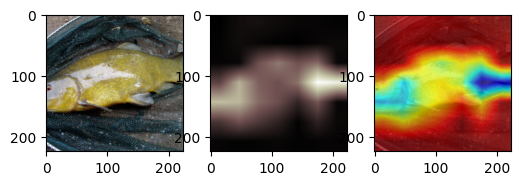

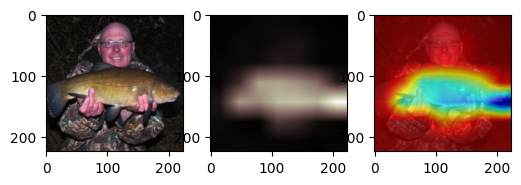

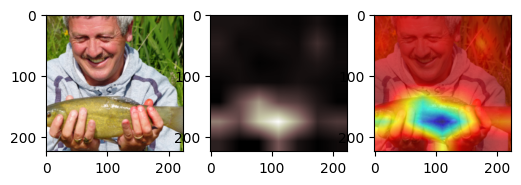

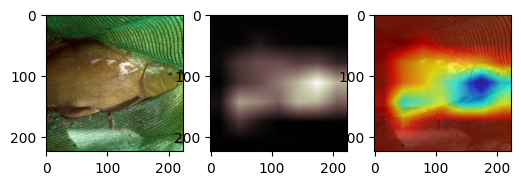

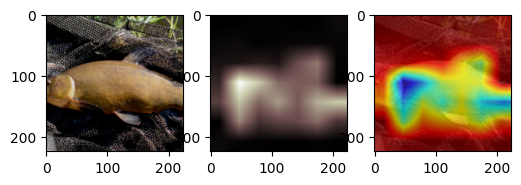

...

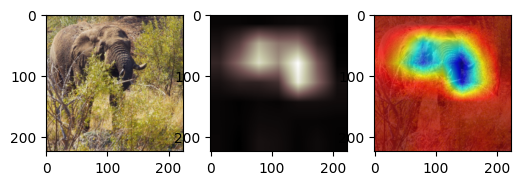

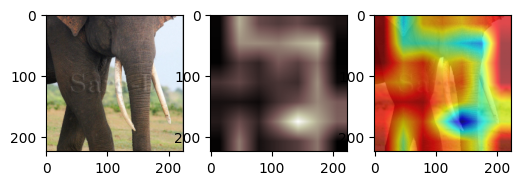

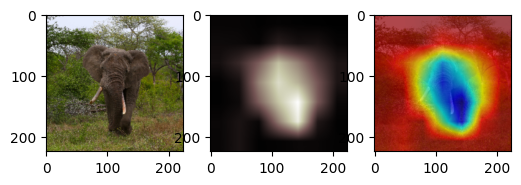

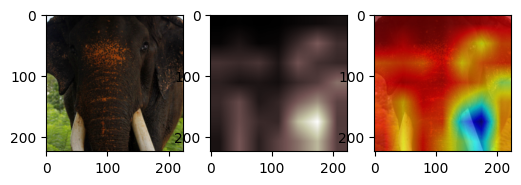

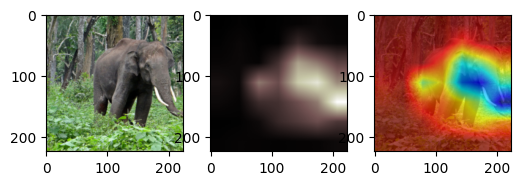

In [21]:
cam = CAM(resnet50)
images = []
for i in range(len(val_dataset)):
    images.append(val_dataset[i][0])
images = torch.stack(images)

for i in range(len(images)):
    output_cam = cam.show_cam(images.detach()[i].unsqueeze(0), cam.generate_cam(images.detach()[i].unsqueeze(0)))
    cam.plot_cam(denormalize(images.detach()[i]), output_cam[0])

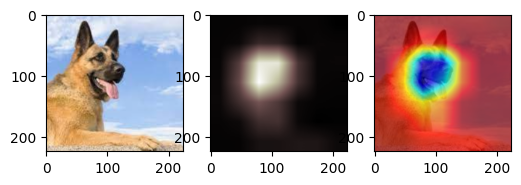

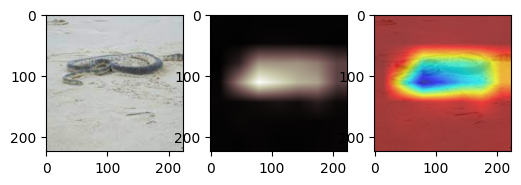

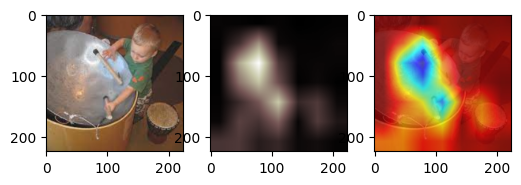

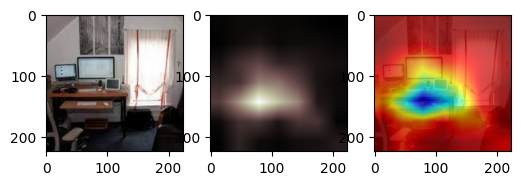

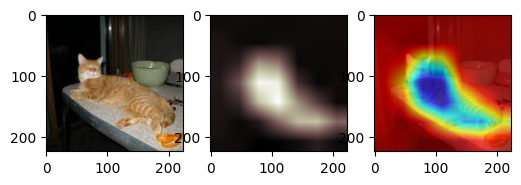

In [23]:
cam = CAM(resnet50)
img_list = []
img_list.append('images2/i1.jpg')
img_list.append('images2/i2.jpg')
img_list.append('images2/i3.jpg')
img_list.append('images2/i4.jpg')
img_list.append('images2/i5.jpg')

for path in img_list:
    img = Image.open(path)
    img = transform(img).unsqueeze(0)
    output_cam = cam.show_cam(img.detach(), cam.generate_cam(img.detach()))
    cam.plot_cam(denormalize(img)[0], output_cam[0])

## Guided GradCAM

For Guided GadCAM, we need to multiply the Guided Backpropagation and Class Activation Map. The following code does the same. Since, our model already has Global Average Pooling layer and it also FC layer at the end, CAM and GradCAM are same.

In [48]:
# Almost working version of GradCAM

# class GradCAM(nn.Module):
#     def __init__(self, model):
#         super(GradCAM, self).__init__()
#         self.resnet_model = models.resnet50(weights=models.ResNet50_Weights.DEFAULT)
#         self.conv_layers = nn.Sequential(*list(self.resnet_model.children())[:-2])
#         self.gap_layer = model.avgpool
#         self.fc_layer = model.fc
#         # print(self.resnet_model)
#         self.feature_maps = None
#         self.gradients = None
#         self.guided_back = GuidedBackprop(self.resnet_model)
#         # print(self.conv_layers[7])
#         self.conv_hook()
    
#     def conv_hook(self):
#         def hook_function(module, grad_in, grad_out):
#             self.gradients = grad_out[0]
#             # print("Feature Maps: ", self.feature_maps.shape)
#         self.conv_layers[7].register_backward_hook(hook_function)
    
#     def forward(self, image):
#         output = self.conv_layers(image)
#         output = self.gap_layer(output)
#         output = output.view(output.size(0), -1)
#         output = self.fc_layer(output)
#         return output
    
#     def get_cam(self, image):
#         pred = self.resnet_model(image)
#         label = pred[:, pred.argmax(dim=1, keepdim=True)]
#         # print(pred, label)
#         # print("Pred: ", pred.shape)
#         # print("Label: ", label.shape)
#         # print(pred.argmax(dim=1, keepdim=True))
#         label.backward()
#         # pool the gradients across the channels
#         gradients = self.gradients.clone()
#         # print("Gradients: ", gradients.shape)
#         gradients = gradients.permute(1, 0, 2, 3).reshape(gradients.shape[1], -1)
#         gradients = torch.mean(gradients, dim=1)
#         # print("Pooled: ", gradients.shape)
#         # # reshape gradients to (n,)
#         # gradients = gradients.reshape((-1, ))
#         # print("Pooled: ", gradients.shape)
#         feature_map = self.conv_layers(image).detach()
#         # print("feature_map: ", feature_map.shape)

#         # Multiply each feature map by the corresponding gradient value
#         gradients = gradients.reshape((-1, 1, 1))
#         feature_map = feature_map * gradients

            
#         heatmap = torch.mean(feature_map, dim=1)
#         heatmap = torch.nn.ReLU()(heatmap.squeeze())
#         heatmap = heatmap / torch.max(heatmap)
#         heatmap = cv2.resize(np.uint8(255 * heatmap), (224, 224))
#         return heatmap
    
#     def plot_cam(self, image, heatmap, target_class=None):
#         image = image.permute(1, 2, 0).numpy()
#         # plt.imshow(heatmap)
#         # plt.show()
#         # plt.close()
#         # print(type(image))
#         # convert image to torch tensor and normalize
        
#         self.guided_back.calculate_gradients(torch.from_numpy(image).permute(2, 0, 1).unsqueeze(0).float(), target_class)
#         # print("Guided Back: ", self.guided_back.gradients.shape)
#         # plt.imshow(self.guided_back.gradients[0, 0, :, :])
#         # plt.show()
#         # plt.close()
        
#         # heatmap = cv2.applyColorMap(np.uint8(255*heatmap), cv2.COLORMAP_JET)
#         # heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
#         # print(heatmap[:, :, 0] - heatmap[:, :, 2])
#         # # print("new")
#         # plt.imshow(image)
#         # plt.imshow(heatmap, alpha=0.4)
#         # plt.show()
#         # plt.close()
        
        
#         # guided heatmap is the element-wise multiplication of guided backpropagation and heatmap
#         # convert guided backpropagation to numpy array and resize it to the size of the image
#         guided_back = self.guided_back.gradients.squeeze().numpy()
#         # print("Guided Back: ", guided_back.shape)
#         # print("Heatmap: ", heatmap.shape)
#         heatmap = np.float32(heatmap) / 255
#         guided_heatmap = np.multiply(guided_back, heatmap)
#         guided_heatmap = guided_heatmap.transpose((1, 2, 0))
    
#         plt.figure(figsize=(5, 5))
#         plt.subplot(1, 2, 1)
#         plt.imshow(image)
#         plt.subplot(1, 2, 2)
#         plt.imshow(guided_heatmap)
#         plt.show()
#         plt.close()
#         # plt.imshow(image)
#         # plt.imshow(guided_heatmap, alpha=0.4)
#         # plt.show()
#         # plt.close()
        
#         # heatmap = heatmap.numpy()
#         # heatmap = cv2.resize(heatmap, (224, 224))
#         # heatmap = np.uint8(255 * heatmap)
#         # plt.imshow(heatmap)
#         # plt.show()
#         # plt.close()
#         # heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
#         # # superimposed_img = heatmap * 0.4 + image
#         # plt.imshow(image)
#         # plt.imshow(heatmap, alpha=0.5)
#         # plt.show()
#         # plt.close()
        


In [31]:
class GradCAM(nn.Module):
    def __init__(self, model):
        super(GradCAM, self).__init__()
        self.resnet_model = models.resnet50(weights=models.ResNet50_Weights.DEFAULT)
        self.conv_layers = nn.Sequential(*list(self.resnet_model.children())[:-2])
        self.gap_layer = model.avgpool
        self.fc_layer = model.fc
        # print(self.resnet_model)
        self.feature_maps = None
        self.gradients = None
        self.guided_back = GuidedBackprop(self.resnet_model)
        self.cam_model = CAM(self.resnet_model)
        # print(self.conv_layers[7])
        self.conv_hook()
    
    def conv_hook(self):
        def hook_function(module, grad_in, grad_out):
            self.gradients = grad_out[0]
            # print("Feature Maps: ", self.feature_maps.shape)
        self.conv_layers[7].register_backward_hook(hook_function)
    
    def forward(self, image):
        output = self.conv_layers(image)
        output = self.gap_layer(output)
        output = output.view(output.size(0), -1)
        output = self.fc_layer(output)
        return output
    
    def get_cam(self, image):
        pred = self.resnet_model(image)
        label = pred[:, pred.argmax(dim=1, keepdim=True)]
        # print(pred, label)
        # print("Pred: ", pred.shape)
        # print("Label: ", label.shape)
        # print(pred.argmax(dim=1, keepdim=True))
        label.backward()
        # pool the gradients across the channels
        gradients = self.gradients.clone()
        # print("Gradients: ", gradients.shape)
        gradients = gradients.permute(1, 0, 2, 3).reshape(gradients.shape[1], -1)
        gradients = torch.mean(gradients, dim=1)
        # print("Pooled: ", gradients.shape)
        # # reshape gradients to (n,)
        # gradients = gradients.reshape((-1, ))
        # print("Pooled: ", gradients.shape)
        feature_map = self.conv_layers(image).detach()
        # print("feature_map: ", feature_map.shape)

        # Multiply each feature map by the corresponding gradient value
        gradients = gradients.reshape((-1, 1, 1))
        feature_map = feature_map * gradients

            
        heatmap = torch.mean(feature_map, dim=1)
        heatmap = torch.nn.ReLU()(heatmap.squeeze())
        heatmap = heatmap / torch.max(heatmap)
        heatmap = cv2.resize(np.uint8(255 * heatmap), (224, 224))
        return heatmap
    
    def plot_cam(self, image, heatmap, target_class=None):
        image = image.permute(1, 2, 0).numpy()
        # plt.imshow(heatmap)
        # plt.show()
        # plt.close()
        # print(type(image))
        # convert image to torch tensor and normalize
        img = torch.from_numpy(image).permute(2, 0, 1).unsqueeze(0).float()
        # print("Image: ", img.shape)
        self.guided_back.calculate_gradients(img, target_class)
        output_cam = self.cam_model.show_cam(img.detach(), [self.cam_model.generate_cam(img.detach())[0]])
        heatmap = output_cam[0]
        
        # print("Guided Back: ", self.guided_back.gradients.shape)
        # plt.imshow(self.guided_back.gradients[0, 0, :, :])
        # plt.show()
        # plt.close()
        
        # heatmap = cv2.applyColorMap(np.uint8(255*heatmap), cv2.COLORMAP_JET)
        # heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
        # print(heatmap[:, :, 0] - heatmap[:, :, 2])
        # # print("new")
        # plt.imshow(image)
        # plt.imshow(heatmap, alpha=0.4)
        # plt.show()
        # plt.close()
        
        
        # guided heatmap is the element-wise multiplication of guided backpropagation and heatmap
        # convert guided backpropagation to numpy array and resize it to the size of the image
        guided_back = self.guided_back.gradients.squeeze().numpy()
        # print("Guided Back: ", guided_back.shape)
        # print("Heatmap: ", heatmap.shape)
        heatmap = np.float32(heatmap) / 255
        guided_heatmap = np.multiply(guided_back, heatmap)
        guided_heatmap = guided_heatmap.transpose((1, 2, 0))
    
        plt.figure(figsize=(5, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(image)
        plt.subplot(1, 2, 2)
        plt.imshow(guided_heatmap)
        plt.show()
        plt.close()
        # plt.imshow(image)
        # plt.imshow(guided_heatmap, alpha=0.4)
        # plt.show()
        # plt.close()
        
        # heatmap = heatmap.numpy()
        # heatmap = cv2.resize(heatmap, (224, 224))
        # heatmap = np.uint8(255 * heatmap)
        # plt.imshow(heatmap)
        # plt.show()
        # plt.close()
        # heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
        # # superimposed_img = heatmap * 0.4 + image
        # plt.imshow(image)
        # plt.imshow(heatmap, alpha=0.5)
        # plt.show()
        # plt.close()
        


c:\Users\sumit\AppData\Local\Programs\Python\Python39\lib\site-packages\torch\nn\modules\module.py:1053: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "


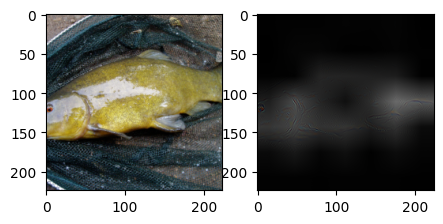

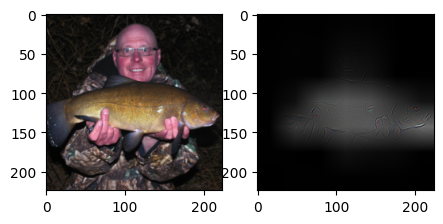

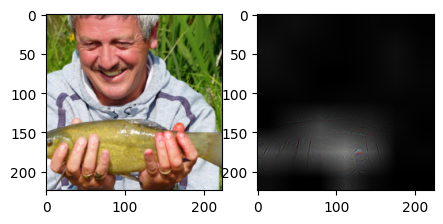

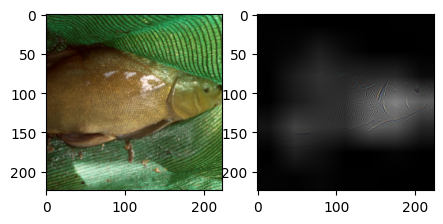

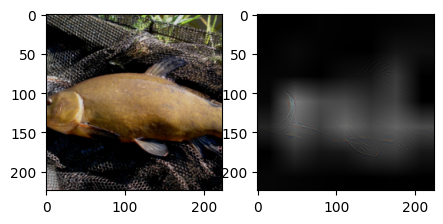

...

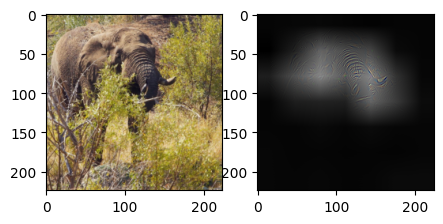

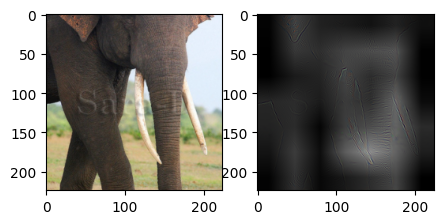

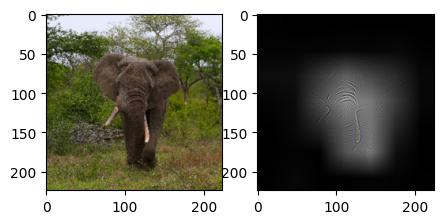

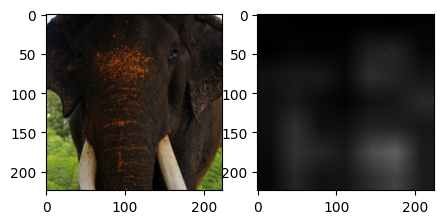

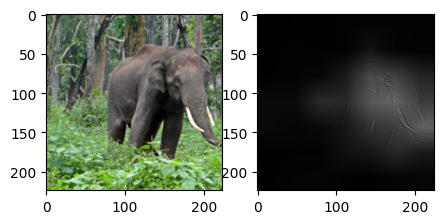

In [26]:
gradcam = GradCAM(resnet50)

images = []
target_class = []
for i in range(len(val_dataset)):
    images.append(val_dataset[i][0])
    target_class.append(val_dataset[i][1])
images = torch.stack(images)

for i in range(len(images)):
    output_cam2 = gradcam.get_cam(images.detach()[i].unsqueeze(0))
    gradcam.plot_cam(denormalize(images.detach()[i]), output_cam2, target_class=target_class[i])

# output_cam2 = gradcam.get_cam(images.detach()[1].unsqueeze(0))
# # print(output_cam2)
# # print max value of heatmap
# # print(np.max(output_cam2))
# gradcam.plot_cam(denormalize(images.detach()[1]), output_cam2, target_class=target_class[1])



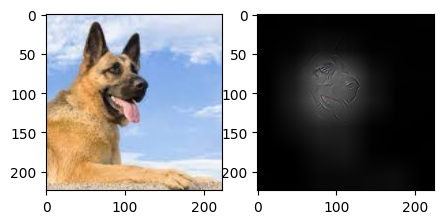

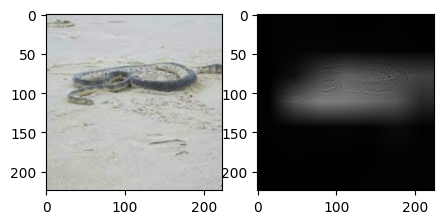

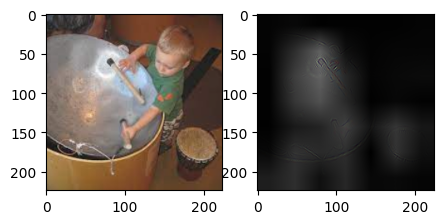

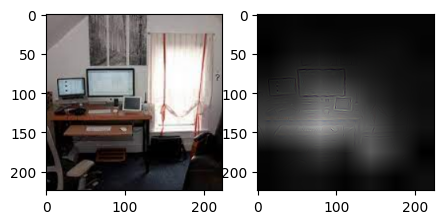

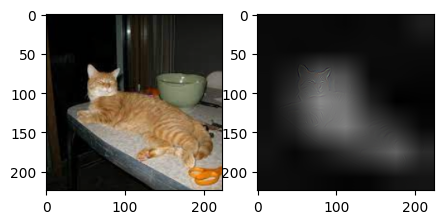

In [32]:
gradcam = GradCAM(resnet50)
img_list = []
img_list.append('images2/i1.jpg')
img_list.append('images2/i2.jpg')
img_list.append('images2/i3.jpg')
img_list.append('images2/i4.jpg')
img_list.append('images2/i5.jpg')

for path in img_list:
    img = Image.open(path)
    img = transform(img).unsqueeze(0)
    output_cam2 = gradcam.get_cam(img)
    gradcam.plot_cam(denormalize(img).squeeze(0), output_cam2)

Reference:

https://towardsdatascience.com/the-one-pytorch-trick-which-you-should-know-2d5e9c1da2ca

https://blog.paperspace.com/pytorch-hooks-gradient-clipping-debugging/

https://medium.com/the-dl/how-to-use-pytorch-hooks-5041d777f904

# Q2

In [91]:
# make dir of name gif_output
import os
os.mkdir('gif_output')

In [104]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
np.random.seed(0)

# if True:
#     return

# Defining the function f(x) = 10x^2 + y^2
def f(x, y):
    return 10 * x ** 2 + y ** 2

def df_dx(x, y):
    return 20 * x

def df_dy(x, y):
    return 2 * y

# Vanilla SGD update rule
def vanilla_sgd(x, y, learning_rate):
    x = x - learning_rate * df_dx(x, y)
    y = y - learning_rate * df_dy(x, y)
    return x, y

# SGD with momentum update rule
def sgd_momentum(x, y, learning_rate, momentum_coeff, v_x=0, v_y=0):
    v_x = momentum_coeff * v_x + learning_rate * df_dx(x, y)
    v_y = momentum_coeff * v_y + learning_rate * df_dy(x, y)
    x = x - v_x
    y = y - v_y
    return x, y, v_x, v_y

# SGD with Nesterov momentum update rule
def sgd_nesterov(x, y, learning_rate, momentum_coeff, v_x=0, v_y=0):
    v_x = momentum_coeff * v_x + learning_rate * df_dx(x - momentum_coeff * v_x, y - momentum_coeff * v_y)
    v_y = momentum_coeff * v_y + learning_rate * df_dy(x - momentum_coeff * v_x, y - momentum_coeff * v_y)
    x = x - v_x
    y = y - v_y
    return x, y, v_x, v_y

# AdaGrad update rule
def adagrad(x, y, learning_rate, epsilon, G_x=0, G_y=0):
    G_x = G_x + df_dx(x, y) ** 2
    G_y = G_y + df_dy(x, y) ** 2
    x = x - learning_rate * df_dx(x, y) / (np.sqrt(G_x) + epsilon)
    y = y - learning_rate * df_dy(x, y) / (np.sqrt(G_y) + epsilon)
    return x, y, G_x, G_y

# RMSProp update rule
def rmsprop(x, y, learning_rate, beta, epsilon, G_x=0, G_y=0):
    G_x = beta * G_x + (1 - beta) * df_dx(x, y) ** 2
    G_y = beta * G_y + (1 - beta) * df_dy(x, y) ** 2
    x = x - learning_rate * df_dx(x, y) / (np.sqrt(G_x) + epsilon)
    y = y - learning_rate * df_dy(x, y) / (np.sqrt(G_y) + epsilon)
    return x, y, G_x, G_y

# update_rule_dict = {'vanilla_sgd': vanilla_sgd,
#                     'sgd_momentum': sgd_momentum,
#                     'sgd_nesterov': sgd_nesterov,
#                     'adagrad': adagrad,
#                     'rmsprop': rmsprop}


# Animation function for visualizing the convergence of the optimization algorithms
def animate(a, update_rule, learning_rate, momentum_coeff, epsilon, beta):
    # Global variables to store the current point
    global x, y
    # Global variables to store the current velocity
    global v_x, v_y
    # Global variables to store the current G_x, G_y
    global G_x, G_y
    # Global variables to store the points visited by the optimization algorithms
    global x_points, y_points
    # print(learning_rate, momentum_coeff, epsilon, beta)
    # # global update rule
    # global update_rule
    # print("Update rule: ", update_rule)
    if update_rule == 'vanilla_sgd':
        x, y = vanilla_sgd(x, y, learning_rate)
    elif update_rule == 'sgd_momentum':
        x, y, v_x, v_y = sgd_momentum(x, y, learning_rate, momentum_coeff, v_x, v_y)
    elif update_rule == 'sgd_nesterov':
        x, y, v_x, v_y = sgd_nesterov(x, y, learning_rate, momentum_coeff, v_x, v_y)
    elif update_rule == 'adagrad':
        x, y, G_x, G_y = adagrad(x, y, learning_rate, epsilon, G_x, G_y)
    elif update_rule == 'rmsprop':
        x, y, G_x, G_y = rmsprop(x, y, learning_rate, beta, epsilon, G_x, G_y)
    
    # Append the current point to the list of points visited
    x_points.append(x)
    y_points.append(y)
    
    # Update the plot
    plt.cla()
    plt.contour(X, Y, Z, levels=30)
    plt.contourf(X, Y, Z, levels=30, cmap='RdGy')
    plt.plot(x_points, y_points, 'k-')
    plt.scatter(x_points, y_points, c='k')
    plt.scatter(0,0, c='r', marker='*')
    plt.title('Convergence of optimization algorithms: {}: Iteration {}'.format(update_rule, len(x_points)))
    plt.xlabel('x')
    plt.ylabel('y')

# Defining the initial point
# x, y = np.random.uniform(-1, 1, 2)
num_iterations = 50

X, Y = np.meshgrid(np.linspace(-3, 3, 100), np.linspace(-3, 3, 100))
Z = f(X, Y)

update_rules = ['vanilla_sgd', 'sgd_momentum', 'sgd_nesterov', 'adagrad', 'rmsprop']

# Hyperparameters
learning_rate = 0.1
momentum_coeff = 0.9
epsilon = 1e-8
beta = 0.9

learning_rate_list = [1, 0.1, 0.01, 0.001, 0.0001]
momentum_coeff_list = [0.5, 0.75, 0.9, 0.95, 0.99]
epsilon_list = [1e-8, 1e-7, 1e-6]
beta_list = [0.5, 0.75, 0.9, 0.95, 0.99]

def run(update_rule, learning_rate, momentum_coeff, epsilon, beta):
    global x, y, x_points, y_points, v_x, v_y, G_x, G_y
    v_x = 0
    v_y = 0
    G_x = 0
    G_y = 0
    x, y = np.random.uniform(-2, 2, 2)
    # print(x,y)
    # print("Starting Point: ({0:.3f},{1:.3f})".format(x, y))
    x_points = [x]
    y_points = [y]
    fig = plt.figure(figsize=(10, 10))
    anim = FuncAnimation(fig, animate, frames=num_iterations, interval=1000, fargs=(update_rule, learning_rate, momentum_coeff, epsilon, beta))

    if update_rule == 'vanilla_sgd':
        anim.save('gif_output/{}_lr_{}.gif'.format(update_rule, learning_rate))
        plt.close()
        print("Vanilla SGD: Learning rate: ", learning_rate)
        print("Starting Point: ({0:.3f},{1:.3f}), Ending Point: ({2:.3f},{3:.3f})".format(x_points[0], y_points[0], x_points[-1], y_points[-1]))
        # print(x_points)
    elif update_rule == 'sgd_momentum':
        anim.save('gif_output/{}_lr_{}_mc_{}.gif'.format(update_rule, learning_rate, momentum_coeff))
        plt.close()
        print("SGD with Momentum: Learning rate: ", learning_rate, " Momentum Coefficient: ", momentum_coeff)
        print("Starting Point: ({0:.3f},{1:.3f}), Ending Point: ({2:.3f},{3:.3f})".format(x_points[0], y_points[0], x_points[-1], y_points[-1]))
    elif update_rule == 'sgd_nesterov':
        anim.save('gif_output/{}_lr_{}_mc_{}.gif'.format(update_rule, learning_rate, momentum_coeff))
        plt.close()
        print("SGD with Nesterov Momentum: Learning rate: ", learning_rate, " Momentum Coefficient: ", momentum_coeff)
        print("Starting Point: ({0:.3f},{1:.3f}), Ending Point: ({2:.3f},{3:.3f})".format(x_points[0], y_points[0], x_points[-1], y_points[-1]))
    elif update_rule == 'adagrad':  
        anim.save('gif_output/{}_lr_{}_eps_{}.gif'.format(update_rule, learning_rate, epsilon))
        plt.close()
        print("Adagrad: Learning rate: ", learning_rate, " Epsilon: ", epsilon)
        print("Starting Point: ({0:.3f},{1:.3f}), Ending Point: ({2:.3f},{3:.3f})".format(x_points[0], y_points[0], x_points[-1], y_points[-1]))
    elif update_rule == 'rmsprop':
        anim.save('gif_output/{}_lr_{}_beta_{}_eps_{}.gif'.format(update_rule, learning_rate, beta, epsilon))
        plt.close()
        print("RMSprop: Learning rate: ", learning_rate, " Beta: ", beta, " Epsilon: ", epsilon)
        print("Starting Point: ({0:.3f},{1:.3f}), Ending Point: ({2:.3f},{3:.3f})".format(x_points[0], y_points[0], x_points[-1], y_points[-1]))
    else :
        anim.save('gif_output/{}.gif'.format(update_rule))
        plt.close()
        print("Update rule: ", update_rule)
    
    


for update_rule in update_rules:
    if update_rule == 'vanilla_sgd':
        for learning_rate in learning_rate_list:
            run(update_rule, learning_rate, momentum_coeff, epsilon, beta)
    elif update_rule == 'sgd_momentum':
        for learning_rate in learning_rate_list:
            for momentum_coeff in momentum_coeff_list:
                run(update_rule, learning_rate, momentum_coeff, epsilon, beta)
    elif update_rule == 'sgd_nesterov':
        for learning_rate in learning_rate_list:
            for momentum_coeff in momentum_coeff_list:
                run(update_rule, learning_rate, momentum_coeff, epsilon, beta)
    elif update_rule == 'adagrad':
        for learning_rate in learning_rate_list:
            for epsilon in epsilon_list:
                run(update_rule, learning_rate, momentum_coeff, epsilon, beta)
    elif update_rule == 'rmsprop':
        for learning_rate in learning_rate_list:
            for beta in beta_list:
                for epsilon in epsilon_list:
                    run(update_rule, learning_rate, momentum_coeff, epsilon, beta)
    else:
        run(update_rule, learning_rate, momentum_coeff, epsilon, beta)

# for update_rule in update_rules:
#     v_x = 0
#     v_y = 0
#     G_x = 0
#     G_y = 0
#     x, y = np.random.uniform(-2, 2, 2)
#     x_points = [x]
#     y_points = [y]
#     fig = plt.figure(figsize=(10, 10))
#     learning_rate = 0.01
#     anim = FuncAnimation(fig, animate, frames=num_iterations, interval=1000, fargs=(update_rule, learning_rate, momentum_coeff, epsilon, beta))
#     anim.save('gif_output/{}.gif'.format(update_rule))
#     plt.close()
#     print("Update rule: ", update_rule)
#     # print(x_points, y_points)


Vanilla SGD: Learning rate:  1
Starting Point: (0.195,0.861), Ending Point: (-32139093507086821161950694225512418393723187394027495265652441088.000,-0.861)
Vanilla SGD: Learning rate:  0.1
Starting Point: (0.411,0.180), Ending Point: (-0.411,0.000)
Vanilla SGD: Learning rate:  0.01
Starting Point: (-0.305,0.584), Ending Point: (-0.000,0.208)
Vanilla SGD: Learning rate:  0.001
Starting Point: (-0.250,1.567), Ending Point: (-0.089,1.415)
Vanilla SGD: Learning rate:  0.0001
Starting Point: (1.855,-0.466), Ending Point: (1.675,-0.462)
SGD with Momentum: Learning rate:  1  Momentum Coefficient:  0.5
Starting Point: (1.167,0.116), Ending Point: (-47054175444880091929696690342133696755117624528240794684186689536.000,0.000)
SGD with Momentum: Learning rate:  1  Momentum Coefficient:  0.75
Starting Point: (0.272,1.702), Ending Point: (-5342291645678466622247299825765787040817997223183864652344852480.000,0.002)
SGD with Momentum: Learning rate:  1  Momentum Coefficient:  0.9
Starting Point: (-1.

Choosing the best hyperparameters can help with the convergence of the algorithm.

In the case of Vanilla SGD choosing a lower learning rate can help with the convergence but it will slower, whereas choosing a higher learning rate can help with the convergence but it will be unstable.

In the case of SGD with momentum, a lower learning rate can help with convergence but it will be slower. For momentum, a lower momentum would mean SGD without momentum and choosing a higher value around 0.9 would help with the convergence.

In the case of SGD with Nesterov momentum, a lower learning rate can help with convergence but it will be slower. For momentum, a lower momentum would mean SGD without momentum and choosing a higher value around 0.9 would help with the convergence.

In the case of Adagrad choosing a learning rate of 0.1 can help with faster convergence while choosing a lower learning rate will converge very slowly. For epsilon, a lower value will lead to better convergence

In the case of RMSprop, learning rate of 0.1 can help with faster convergence, beta value of around 0.9 and a smaller epsilon value seem to have converged a lot better.


The above results are generated by initializing the points randomly for each hyperparameter setting and has been run over only 50 iterations.

Reference:

https://towardsdatascience.com/stochastic-gradient-descent-with-momentum-a84097641a5d

https://krmopuri.github.io/dl/static_files/presentations/dl-11.pdf

In [ ]:
# class GuidedBackprop():
#     def __init__(self, model):
#         self.model = model
#         self.gradients = None
#         self.num_images = 0
        
#     def calculate_gradients(self, image, target_class=None):
#         image.requires_grad = True
#         self.num_images = image.shape[0]
#         self.model.eval()
        
#         output = self.model(image)
#         print("Output Shape: ", output.shape)
#         # pred = output.argmax(dim=1, keepdim=True)
        
#         # output[:, pred].sum().backward()
#         self.model.zero_grad()
#         one_hot_vector = torch.zeros(output.shape)
#         one_hot_vector[torch.arange(self.num_images), target_class] = 1
        
#         output.backward(gradient=one_hot_vector)
        
#         self.gradients = image.grad
#         self.gradients = self.gradients.clamp(min=0.0)
#         for i in range(self.num_images):
#             self.gradients[i] = self.gradients[i] - self.gradients[i].min()
#             self.gradients[i] = self.gradients[i] / self.gradients[i].max()
#         return self.gradients
    
#     def plot_gradients(self, image):
#         fig, ax = plt.subplots(self.num_images, 2, figsize=(5, 100))
#         for i in range(self.num_images):
#             ax[i, 0].imshow(denormalize(image[i]).permute(1, 2, 0))
#             ax[i, 0].axis('off')
#             ax[i, 1].imshow(self.gradients[i].permute(1, 2, 0))
#             ax[i, 1].axis('off')
#         # plt.show()
#         fig.tight_layout()
#         plt.savefig('guided_backprop.png')
        
#     def guided_backprop(self, image):
#         self.calculate_gradients(image)
        
#         self.plot_gradients(image.detach())
#         return self.gradients

In [27]:
# class CAM():
#     def __init__(self, model, target_layer):
#         self.model = model
#         self.gradients = None
#         self.num_images = 0
#         self.activations = []
#         self.weights = None
#         self.target_layer = target_layer
#         self.hook_layers()
#         self.cam = None
        
#     def hook_layers(self):
#         def hook_function(module, input, output):
#             self.activations.append(output)
        
#         target_layer = self.model._modules.get(self.target_layer)
#         target_layer.register_forward_hook(hook_function)
            
            
        
#     def cam_function(self, image, final_conv, target_class=None):
#         self.model.eval()
        
#         output = self.model(image)
#         self.model.zero_grad()
        
#         one_hot_vector = torch.zeros(output.shape)
#         one_hot_vector[torch.arange(self.num_images), target_class] = 1
        
#         output.backward(gradient=one_hot_vector, retain_graph=True)
#         self.gradients = torch.empty(self.num_images, self.activations[0].shape[1], self.activations[0].shape[2], self.activations[0].shape[3])
#         for i in range(self.num_images):
#             self.gradients[i] = self.activations[i].grad
#         gap_grad = nn.functional.adaptive_avg_pool2d(self.gradients, 1)
        
#         for i in range(self.num_images):
#             for j in range(self.gradients.shape[1]):
#                 self.weights[i, j] *= gap_grad[i, j, 0, 0]
                
#         self.cam = torch.mean(torch.Tensor(self.activations), dim=0)
#         self.cam = F.relu(self.cam)
#         self.cam = self.cam - self.cam.min()
#         self.cam = self.cam / self.cam.max()
        
#         return self.cam
    
#     def plot_cam(self, image):
#         fig, ax = plt.subplots(self.num_images, 2, figsize=(5, 100))
#         for i in range(self.num_images):
#             ax[i, 0].imshow(denormalize(image[i]).permute(1, 2, 0))
#             ax[i, 0].axis('off')
#             ax[i, 1].imshow(self.cam[i].detach().cpu().numpy(), cmap='jet')
#             ax[i, 1].axis('off')
#         # plt.show()
#         fig.tight_layout()
#         plt.savefig('cam.png')
#         plt.close()
        

In [81]:
# class CAM(nn.Module):
#     def __init__(self, model, num_features, target_layer):
#         super(CAM, self).__init__()
#         self.model = model
#         # print(self.model)
#         self.model_features = nn.Sequential(*list(self.model.children())[:-2])
#         # freeze the model features
#         for param in self.model_features.parameters():
#             param.requires_grad = False
#         # print("Model Features: ")
#         # print(self.model_features)
#         self.num_features = num_features
#         self.target_layer = target_layer
#         self.gap_layer = nn.AdaptiveAvgPool2d((1,1))
#         self.fully_connected = nn.Linear(self.num_features, self.target_layer)
#         # insert gap_layer and fully_connected layer to the model
#         self.model.classifier = nn.Sequential(self.gap_layer, self.fully_connected)
#         # print(self.model)
        
        
#     def get_convolution_output(self, image):
#         self.model.eval()
#         output = self.model_features(image)
#         # print("Shape of Output Convolution: ", output.shape)
#         return output
    
#     def forward(self, image, target_class=None):
#         output = self.get_convolution_output(image)
#         # output = self.gap_layer(output)
#         # print("Shape of GAP Layer: ", output.shape)
#         output = output.view(output.size(0), -1)
#         output = self.fully_connected(output)
#         # print("Shape of Fully Connected Layer: ", output.shape)
#         return output
    
#     def train_model(self, trainloader, epochs=10):
#         criterion = nn.CrossEntropyLoss()
#         optimizer = optim.SGD(self.model.parameters(), lr=0.001, momentum=0.9)
#         for epoch in range(epochs):
#             running_loss = 0.0
#             for i, data in enumerate(trainloader, 0):
#                 inputs, labels = data
#                 optimizer.zero_grad()
                
#                 outputs = self.forward(inputs)
#                 loss = criterion(outputs, labels)
#                 loss.backward()
#                 optimizer.step()
                
#                 running_loss += loss.item()
#                 if i % 2000 == 1999:
#                     print('[%d, %5d] loss: %.3f' % (epoch+1, i+1, running_loss/2000))
#                     running_loss = 0.0  
#         print('Finished Training')
    
#     def get_cam(self, image, target_class=None):
#         pred = self.model_features(image)
#         pred = self.gap_layer(pred)
#         pred = pred.view(pred.size(0), -1)

        

In [129]:
# class CAM(nn.Module):
#     def __init__(self, model, num_features, target_layer):
#         super(CAM, self).__init__()
#         self.model = model
#         self.model_features = nn.Sequential(*list(self.model.children())[:-3])
#         # print(self.model_features)
#         self.gap_layer = nn.AdaptiveAvgPool2d((1,1))
#         self.fully_connected = self.model.fc
#         print(self.fully_connected)
#         self.model.eval()
#         self.fc_weight = self.fully_connected.weight.data
        
#     def forward(self, image):
#         output = self.model_features(image)
#         output = self.gap_layer(output)
#         output = output.view(output.size(0), -1)
#         return output
    
#     def get_cam(self, image):
#         convoluted_output = self.forward(image)
#         target_class = torch.argmax(self.fully_connected(convoluted_output), dim=1)
#         # Get the 2048 input weights to the softmax of the target class
#         target_class_weights = self.fc_weight[target_class]
        
#         # get the final conv layer
#         final_conv_layer = list(self.model.children())[-3]
        
#         # fetch the final conv layer output maps (should be shape (1, 7, 7, 2048))
#         final_conv_layer_output = final_conv_layer(image)
#         print("SHape conv: ", final_conv_layer_output.shape)
        
#         # squeeze conv map to shape image to size (7, 7, 2048)
#         final_conv_layer_output = final_conv_layer_output.squeeze(0)
#         print("Shape conv: ", final_conv_layer_output.shape)
#         # bilinear upsampling to resize each filtered image to size of original image
#         cam = torch.nn.functional.interpolate(final_conv_layer_output, size=(224, 224), mode='bilinear', align_corners=False)
#         # get class activation map for object class that is predicted to be in the image
#         print(cam.shape)
#         print(target_class_weights.shape)
#         cam = torch.sum(cam * target_class_weights, dim=0)
    
    
#         return cam
    
    
#     def plot_cam(self, image, cam):
#         fig, ax = plt.subplots(image.shape[0], 2, figsize=(5, 100))
#         for i in range(image.shape[0]):
#             ax[i, 0].imshow(denormalize(image[i]).permute(1, 2, 0))
#             ax[i, 0].axis('off')
#             ax[i, 1].imshow(cam[i].detach().cpu().numpy(), cmap='jet')
#             ax[i, 1].axis('off')
#         plt.show()
#         # fig.tight_layout()
#         # plt.savefig('cam.png')
#         plt.close()


In [162]:
# class CAM(nn.Module):
#     def __init__(self, model):
#         super(CAM, self).__init__()
#         self.model = model
#         self.model.eval()
#         self.model = nn.Sequential(model, nn.Softmax(dim=1))
        
#         model_fc = model.fc.state_dict()
#         in_ch = model.fc.in_features
#         out_ch = model.fc.out_features
#         final_conv = nn.Conv2d(in_ch, out_ch, 1, 1)
#         final_conv.load_state_dict({"weight": model_fc["weight"].view(out_ch, in_ch, 1, 1), "bias": model_fc["bias"]})
#         model_conv = nn.Sequential(*list(model.children())[:-2] + [final_conv])
#         model_conv.eval()
#         model.eval()
#         print(model_conv)
    
#     def forward(self, image):
#         with torch.no_grad():
#             output = self.model(image)
#             cam_output = self.model_conv(image)


In [ ]:
# class GuidedGradCAM():
#     def __init__(self, model):
#         self.model = model
#         self.gradients = None
#         self.num_images = 0
#         self.activations = None
#         self.weights = None
        
#     def calculate_gradients(self, image):
#         image.requires_grad = True
#         self.num_images = image.shape[0]
#         self.model.eval()
        
#         output = self.model(image)
#         print("Output Shape: ", output.shape)
#         pred = output.argmax(dim=1, keepdim=True)
        
#         output[:, pred].sum().backward()
        
#         self.gradients = image.grad
#         return self.gradients
    
#     def get_activations(self, image):
#         self.model.eval()
#         self.activations = self.model(image)
#         return self.activations
    
#     def get_weights(self):
#         self.weights = self.gradients.mean(dim=(2, 3), keepdim=True)
#         return self.weights
    
#     def get_cam(self, image):
#         self.calculate_gradients(image)
#         self.get_activations(image)
#         self.get_weights()
#         cam = (self.activations * self.weights).sum(dim=1)
#         cam = cam.clamp(min=0.0)
#         return cam
    
#     def plot_cam(self, image, cam):
#         fig, ax = plt.subplots(self.num_images, 3, figsize=(5, 100))
#         for i in range(self.num_images):
#             ax[i, 0].imshow(denormalize(image[i]).permute(1, 2, 0))
#             ax[i, 1].imshow(cam[i].detach().numpy())
#             ax[i, 2].imshow(denormalize(image[i]).permute(1, 2, 0))
#             ax[i, 2].imshow(cam[i].detach().numpy(), alpha=0.5, cmap='jet')
#         # plt.show()
#         plt.savefig('guided_gradcam.png')
        
#     def guided_gradcam(self, image):
#         cam = self.get_cam(image)
#         cam = cam.clamp(min=0.0)
#         self.plot_cam(image.detach(), cam)
#         return cam

In [ ]:
# # Vanilla Backpropagation
# def vanilla_backprop(model, image, loss_fn):
#     # Set requires_grad attribute of tensor. Important for Attack
#     image.requires_grad = True
#     model.eval()
    
#     # Forward pass
#     output = model(image)
#     print(output.shape)
#     print(output.size()[1])
    
#     # Target is one-hot encoded vector
#     one_hot_output = torch.Tensor(output.size()[0], output.size()[1]).zero_()
#     for i in range(output.size()[0]):
#         one_hot_output[i][torch.argmax(output[i])] = 1
    
#     # pred = torch.argmax(output, dim=1)
#     # print(pred)
    
#     # Zero all existing gradients
#     model.zero_grad()
#     output.backward(gradient=one_hot_output)

#     # # Calculate loss
#     # loss = loss_fn(output, pred)
#     # print(loss)

#     # # Calculate gradients of model in backward pass
#     # loss.backward()
        
#     # Get gradients w.r.t to input
#     grad = image.grad.data
#     grad = grad / (grad.norm() + 1e-10)
#     grad = grad - grad.min()
#     grad = grad / grad.max()

#     # # Normalize the gradients
#     # norm_grad = grad / (grad.norm() + 1e-10)
#     return grad


# images = []
# for i in range(len(val_dataset)):
#     images.append(val_dataset[i][0])
# images = torch.stack(images)
# print(images.shape)

# # # Plot the images
# # fig, ax = plt.subplots(1, 5, figsize=(20, 10))
# # for i in range(10,15):
# #     ax[i-10].imshow(images[i].permute(1, 2, 0))
# # plt.show()


# # output = resnet50(images)
# # print(output)
# # print(torch.argmax(output, dim=1))

# # # Plot all images along with their predicted labels
# # fig, ax = plt.subplots(5, 10, figsize=(30, 20))
# # for i in range(5):
# #     for j in range(10):
# #         ax[i, j].imshow(images[i*10+j].permute(1, 2, 0))
# #         ax[i, j].set_title(torch.argmax(output[i*10+j]))
# # plt.show()



# print(images.shape)
# num_images = images.shape[0]
# loss_fn = nn.CrossEntropyLoss()
# # Get gradients
# gradients = vanilla_backprop(resnet50, images.detach(), loss_fn)
# print(gradients)

# # Visualize the gradients
# fig, ax = plt.subplots(40, 2, figsize=(5, 100))
# for i in range(40):
#     ax[i, 0].imshow(denormalize(images[i]).permute(1, 2, 0))
#     ax[i, 1].imshow(gradients[i].permute(1, 2, 0))
# plt.show()

# # heatmaps = []
# # for i in range(len(images)):
# #     heatmap = cv2.applyColorMap(np.uint8(255 * gradients[i].permute(1, 2, 0).detach().numpy()), cv2.COLORMAP_JET)
# #     heatmap = np.float32(heatmap) / 255
# #     heatmap = cv2.resize(heatmap, (224, 224))
# #     heatmaps.append(heatmap)

# # input_images = images.permute(0, 2, 3, 1).detach().numpy()
# # final_images = []
# # for i in range(num_images):
# #     tmp = cv2.cvtColor(np.uint8(255 * input_images[i]), cv2.COLOR_RGB2BGR)
# #     tmp = cv2.resize(tmp, (224, 224))
# #     final_images.append(tmp)

# # heatmap_images = []
# # for i in range(num_images):
# #     heatmap_image = heatmap * 0.5 + final_images[i]
# #     heatmap_images.append(heatmap_image)

# # # Plot the images
# # fig, axs = plt.subplots(num_images, 3, figsize=(50, 20))
# # for i in range(num_images):
# #     axs[i, 0].imshow(final_images[i])
# #     axs[i, 1].imshow(heatmaps[i])
# #     axs[i, 2].imshow(heatmap_images[i])
# # plt.show()



In [ ]:
# # Vanilla Backpropagation
# def vanilla_backprop(model, image, loss_fn):
#     # Set requires_grad attribute of tensor. Important for Attack
#     image.requires_grad = True
#     model.eval()
    
#     output = model(image)
#     print(output.shape)
    
#     pred = torch.argmax(output, dim=1)
#     output[:, pred].sum().backward()
    
#     grad = image.grad   
#     # grad = grad / (grad.norm() + 1e-6) 
#     # grad = grad - grad.min()
#     # grad = grad / grad.max()
#     return grad


# images = []
# for i in range(len(val_dataset)):
#     images.append(val_dataset[i][0])
# images = torch.stack(images)
# print(images.shape)

# print(images.shape)
# num_images = images.shape[0]
# loss_fn = nn.CrossEntropyLoss()
# # Get gradients
# gradients = vanilla_backprop(resnet50, images.detach(), loss_fn)
# # print(gradients)

# # gradient_grid = torchvision.utils.make_grid(torch.concat((images, gradients), dim=0), nrow=)
# # plt.figure(figsize=(50, 10))
# # plt.imshow(gradient_grid.permute(1, 2, 0))
# # plt.savefig('vanilla_backprop.png')
# # plt.show()



# # Visualize the gradients
# fig, ax = plt.subplots(40, 2, figsize=(5, 100))
# for i in range(40):
#     ax[i, 0].imshow(denormalize(images[i]).permute(1, 2, 0))
#     ax[i, 1].imshow(gradients[i].permute(1, 2, 0))
# plt.show()



In [ ]:
# import numpy as np
# import matplotlib.pyplot as plt
# from matplotlib.animation import FuncAnimation

# # Defining the function f(x) = 10x^2 + y^2
# def f(x, y):
#     return 10 * x ** 2 + y ** 2

# def df_dx(x, y):
#     return 20 * x

# def df_dy(x, y):
#     return 2 * y

# # Vanilla SGD update rule
# def vanilla_sgd(x, y, learning_rate):
#     x = x - learning_rate * df_dx(x, y)
#     y = y - learning_rate * df_dy(x, y)
#     return x, y

# # SGD with momentum update rule
# def sgd_momentum(x, y, learning_rate, momentum_coeff, v_x=0, v_y=0):
#     v_x = momentum_coeff * v_x + learning_rate * df_dx(x, y)
#     v_y = momentum_coeff * v_y + learning_rate * df_dy(x, y)
#     x = x - v_x
#     y = y - v_y
#     return x, y, v_x, v_y

# # SGD with Nesterov momentum update rule
# def sgd_nesterov(x, y, learning_rate, momentum_coeff, v_x=0, v_y=0):
#     v_x = momentum_coeff * v_x + learning_rate * df_dx(x - momentum_coeff * v_x, y - momentum_coeff * v_y)
#     v_y = momentum_coeff * v_y + learning_rate * df_dy(x - momentum_coeff * v_x, y - momentum_coeff * v_y)
#     x = x - v_x
#     y = y - v_y
#     return x, y, v_x, v_y

# # AdaGrad update rule
# def adagrad(x, y, learning_rate, epsilon, G_x=0, G_y=0):
#     G_x = G_x + df_dx(x, y) ** 2
#     G_y = G_y + df_dy(x, y) ** 2
#     x = x - learning_rate * df_dx(x, y) / (np.sqrt(G_x) + epsilon)
#     y = y - learning_rate * df_dy(x, y) / (np.sqrt(G_y) + epsilon)
#     return x, y, G_x, G_y

# # RMSProp update rule
# def rmsprop(x, y, learning_rate, beta, epsilon, G_x=0, G_y=0):
#     G_x = beta * G_x + (1 - beta) * df_dx(x, y) ** 2
#     G_y = beta * G_y + (1 - beta) * df_dy(x, y) ** 2
#     x = x - learning_rate * df_dx(x, y) / (np.sqrt(G_x) + epsilon)
#     y = y - learning_rate * df_dy(x, y) / (np.sqrt(G_y) + epsilon)
#     return x, y, G_x, G_y

# # update_rule_dict = {'vanilla_sgd': vanilla_sgd,
# #                     'sgd_momentum': sgd_momentum,
# #                     'sgd_nesterov': sgd_nesterov,
# #                     'adagrad': adagrad,
# #                     'rmsprop': rmsprop}


# # Animation function for visualizing the convergence of the optimization algorithms
# def animate(a):
#     # Global variables to store the current point
#     global x, y
#     # Global variables to store the current velocity
#     global v_x, v_y
#     # Global variables to store the current G_x, G_y
#     global G_x, G_y
#     # Global variables to store the points visited by the optimization algorithms
#     global x_points, y_points
    
#     # global update rule
#     global update_rule
#     # print("Update rule: ", update_rule)
#     if update_rule == 'vanilla_sgd':
#         x, y = vanilla_sgd(x, y, learning_rate)
#     elif update_rule == 'sgd_momentum':
#         x, y, v_x, v_y = sgd_momentum(x, y, learning_rate, momentum_coeff, v_x, v_y)
#     elif update_rule == 'sgd_nesterov':
#         x, y, v_x, v_y = sgd_nesterov(x, y, learning_rate, momentum_coeff, v_x, v_y)
#     elif update_rule == 'adagrad':
#         x, y, G_x, G_y = adagrad(x, y, learning_rate, epsilon, G_x, G_y)
#     elif update_rule == 'rmsprop':
#         x, y, G_x, G_y = rmsprop(x, y, learning_rate, beta, epsilon, G_x, G_y)
    
#     # Append the current point to the list of points visited
#     x_points.append(x)
#     y_points.append(y)
    
#     # Update the plot
#     plt.contour(X, Y, Z, levels=30)
#     plt.contourf(X, Y, Z, levels=30, cmap='RdGy')
#     plt.plot(x_points, y_points, 'k-')
#     plt.scatter(x_points, y_points, c='k')
#     plt.scatter(0,0, c='r', marker='*')
#     plt.title('Convergence of optimization algorithms: {}: Iteration {}'.format(update_rule, len(x_points)))
#     plt.xlabel('x')
#     plt.ylabel('y')

# # Defining the initial point
# # x, y = np.random.uniform(-1, 1, 2)
# num_iterations = 50

# X, Y = np.meshgrid(np.linspace(-3, 3, 100), np.linspace(-3, 3, 100))
# Z = f(X, Y)

# update_rules = ['vanilla_sgd', 'sgd_momentum', 'sgd_nesterov', 'adagrad', 'rmsprop']

# # Hyperparameters
# learning_rate = 0.1
# momentum_coeff = 0.9
# epsilon = 1e-8
# beta = 0.9


# for update_rule in update_rules:
#     v_x = 0
#     v_y = 0
#     G_x = 0
#     G_y = 0
#     x, y = np.random.uniform(-2, 2, 2)
#     x_points = [x]
#     y_points = [y]
#     fig = plt.figure(figsize=(10, 10))
#     anim = FuncAnimation(fig, animate, frames=num_iterations, interval=1000)
#     anim.save('gif_output/{}.gif'.format(update_rule))
#     plt.close()
#     print("Update rule: ", update_rule)
#     # print(x_points, y_points)
